<a href="https://colab.research.google.com/github/iavode/made2020_lsml/blob/master/neural_university_test_bee_vs_wasp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!cp "/content/drive/MyDrive/Colab Notebooks/beeVSwasp.zip" ./
!unzip -q beeVSwasp.zip -d ./beeVSwasp
!rm -f beeVSwasp.zip

In [3]:
%reload_ext tensorboard

In [4]:
import datetime
from functools import partial
import os
import io
from random import sample
from warnings import filterwarnings

from matplotlib.pyplot import (
    axis, cm, close, figure, grid, imshow, savefig, show, subplot, subplots,
    title, xticks, yticks
)
import numpy as np
from pathlib import Path
from PIL import Image
from sklearn.metrics import f1_score
import tensorflow as tf
from tqdm.notebook import tqdm


filterwarnings("ignore")

DATA_DIR = Path("./beeVSwasp")
AUTOTUNE = tf.data.experimental.AUTOTUNE
RNG = tf.random.Generator.from_seed(123, alg="philox")
# model params
NUM_EPOCHS = 5
BATCH_SIZE = 64
IMG_HEIGHT = 224
IMG_WIDTH = 224
PADDING="SAME"
LEAKY_RELU_ALPHA = 0.2
DROPOUT_PROB = 0.25
CONV_STRIDE = 1
POOL_STRIDE = 2
POOL_KERNEL_SIZE = 2
INITIALIZER = tf.initializers.glorot_uniform()
NUM_CLASSES = 2
OPTIMIZER = tf.optimizers.Adam(learning_rate=3e-4)


SHAPES = [
    [3, 3, 3, 16], [3, 3, 16, 16],
    [3, 3, 16, 32], [3, 3, 32, 32],
    [3, 3, 32, 64], [3, 3, 64, 64],
    [3, 3, 64, 128], [3, 3, 128, 128],
    [3, 3, 128, 256], [3, 3, 256, 256],
    [3, 3, 256, 512], [3, 3, 512, 512],
    [4608, 3600], [3600, 2400],
    [2400, 1600], [1600, 800],
    [800, 64], [64, NUM_CLASSES],
]


In [5]:
def display_image_from_paths(image_paths, fig, axes, fig_title=None):
    """Display images in frame."""
    fig.suptitle(fig_title if fig_title else "")
    axes = axes.ravel()
    for i, path in enumerate(image_paths):
        image = Image.open(path)
        axes[i].imshow(image)
        axes[i].axis("off")
    show()

    
def display_batch(batch):
    """Display generated batch"""
    figure(figsize=(12, 12))
    images, labels = batch
    for i, image in enumerate(images):
        subplot(4, 8, i + 1)
        imshow(image)
        title(f"Class: {'Wasp' if labels[i] else 'Bee'}")
        axis("off")
    show()


# **Посмотрим на данные.**

In [6]:
bee_paths = list(DATA_DIR.glob("bee/*.jpg"))
wasp_paths = list(DATA_DIR.glob("wasp/*.jpg"))
print(f"Quantity of bee's image: {len(bee_paths)}")
print(f"Quantity of wasp's image: {len(wasp_paths)}")

Quantity of bee's image: 2469
Quantity of wasp's image: 2126


In [7]:
random_bee_paths = sample(bee_paths, 9)
random_wasp_paths = sample(wasp_paths, 9)

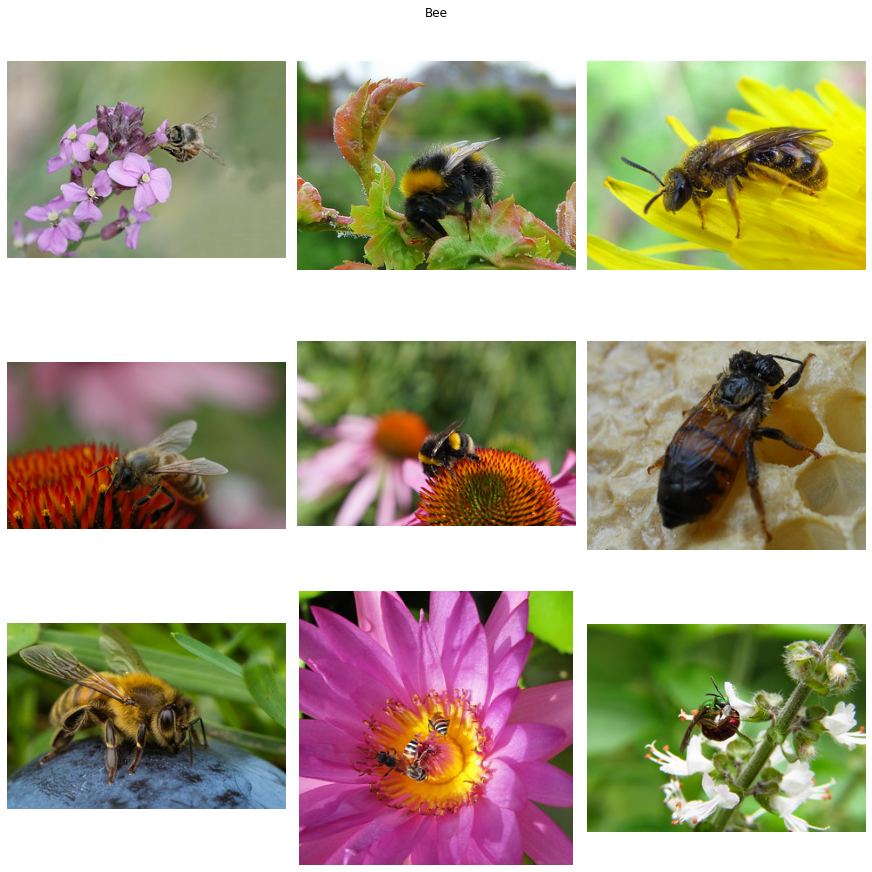

In [8]:
%matplotlib inline
bee_fig, bee_axes = subplots(
    3, 3, figsize=(12, 12), constrained_layout=True, sharey=True
)
display_image_from_paths(random_bee_paths, bee_fig, bee_axes, fig_title="Bee")

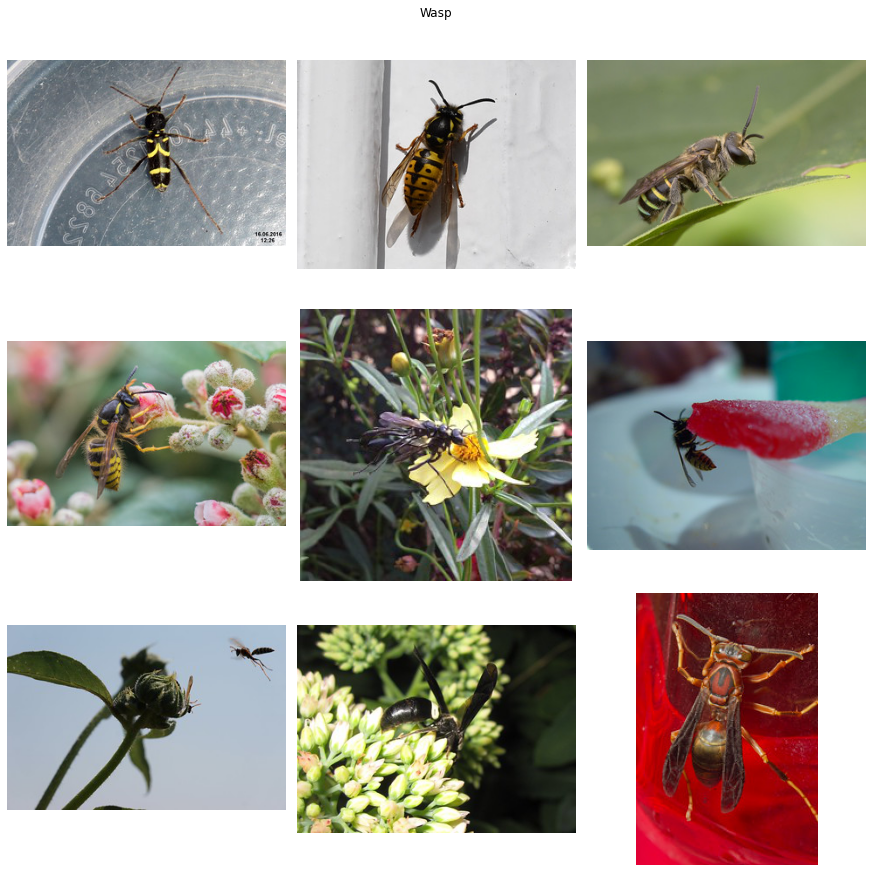

In [9]:
%matplotlib inline
fig_wasp, wasp_axes = subplots(
    3, 3, figsize=(12, 12), constrained_layout=True, sharey=True
)
display_image_from_paths(
    random_wasp_paths, fig_wasp, wasp_axes, fig_title="Wasp"
)

# **Создание датасета**

In [10]:
def get_label(image_path):
    """Set bee - 0, wasp - 1."""
    return tf.cast(tf.strings.split(image_path, "/")[-2] == "wasp", tf.int32)


def preprocess(image_path):
    """Get path, create label, read and decode image."""
    label = get_label(image_path)
    image = tf.io.read_file(image_path)
    return image, label


def central_crop(image):
    shape = tf.shape(image)
    min_dim = tf.reduce_min([shape[0], shape[1]])
    top_crop = (shape[0] - min_dim) // 4
    bottom_crop = shape[0] - top_crop
    left_crop = (shape[1] - min_dim) // 4
    right_crop = shape[1] - left_crop
    return image[top_crop: bottom_crop, left_crop: right_crop]


def random_crop(image):
    shape = tf.shape(image)
    min_dim = tf.reduce_min([shape[0], shape[1]]) * 90 // 100
    return tf.image.random_crop(image, [min_dim, min_dim, 3])


def random_flip(image, seed):
    """Apply left->right, up->down or both."""
    new_seeds = tf.random.experimental.stateless_split(seed, num=1)[0, :]
    image = tf.image.stateless_random_flip_left_right(image, new_seeds)
    image = tf.image.stateless_random_flip_up_down(image, new_seeds)
    return image


def random_color_preprocess(image, seed):
    new_seed = tf.random.experimental.stateless_split(seed, num=1)[0, :]
    image = tf.image.stateless_random_saturation(image, 1, 5, seed=new_seed)
#     image = tf.image.stateless_random_contrast(image, 0.2, 0.8, seed=new_seed)        
#     image = tf.image.stateless_random_brightness(image, 0.75, seed=new_seed)
    return tf.clip_by_value(image, 0, 1)


def cast_resize_and_augmentation(image, augment, randomize):
    """Open, cast, augment, resize"""
    image = tf.image.decode_jpeg(image, channels=3)
    # cast to float
    image = tf.image.convert_image_dtype(image, tf.float32)
    if augment:
        # crop image
        seed = RNG.make_seeds(2)[0]
        if randomize:
            aug_image = random_crop(image)
        else:
            aug_image = central_crop(image)
        # random flip: left->right, up->down
        aug_image = random_flip(aug_image, seed)
        # change contrast | brightness | saturation
        aug_image = random_color_preprocess(aug_image, seed)
        aug_image = tf.image.resize(aug_image, [IMG_WIDTH, IMG_HEIGHT])
        image = tf.image.resize(image, [IMG_WIDTH, IMG_HEIGHT])
        return image, aug_image
    else:
        aug_image = tf.image.resize(image, [IMG_WIDTH, IMG_HEIGHT])
        image = tf.image.resize(image, [IMG_WIDTH, IMG_HEIGHT])
        return image, aug_image


def augmentation(image, label, augment=True, randomize=True):
    """Crop, augment, resize"""
    image, aug_image = cast_resize_and_augmentation(image, augment, randomize)
    return image, aug_image, label
        

def normalize(image, aug_image, label):
    aug_image = tf.image.per_image_standardization(aug_image)
    return image, aug_image, label
    
    
def split_train_validation_dataset(full_dataset, train_ratio):
    """Split full dataset on train and validation."""
    train_size = int(train_ratio * len(full_dataset))
    train_dataset = full_dataset.take(train_size)
    val_dataset = full_dataset.skip(train_size)
    return train_dataset, val_dataset


In [11]:
image_paths = tf.data.Dataset.list_files(str(DATA_DIR / "*/*"), seed=42)
train_image_paths, val_image_paths = split_train_validation_dataset(
    image_paths, train_ratio=0.85
)

# from path to image and label
train_datset = train_image_paths.map(preprocess, num_parallel_calls=AUTOTUNE)
val_dataset = val_image_paths.map(preprocess, num_parallel_calls=AUTOTUNE)
LEN_TRAIN_DATASET = len(train_datset)
LEN_VAL_DATASET = len(val_dataset)
TRAIN_BATCH_Q = len(train_datset) // BATCH_SIZE
TEST_BATCH_Q = len(val_dataset) // BATCH_SIZE

# crop, flip, augment, normalize
train_datset = (
    train_datset. \
        shuffle(1000).map(
            partial(augmentation, augment=True, randomize=True), num_parallel_calls=AUTOTUNE
        ).map(normalize). \
        batch(BATCH_SIZE). \
        prefetch(buffer_size=AUTOTUNE)
)

val_dataset = val_dataset.map(
    partial(augmentation, augment=False, randomize=False),
    num_parallel_calls=AUTOTUNE
)
val_dataset = val_dataset.map(normalize).batch(BATCH_SIZE).prefetch(buffer_size=AUTOTUNE)


# **Создание модели**

In [12]:
def batchnorm(inputs, is_train=True, decay=0.999):
    """
    Wrapper for tf.nn.batch_normalization.
    
    Allow apply the layer on train and test stage.

    """
    scale = tf.Variable(tf.ones([tf.shape(inputs)[-1]]))
    beta = tf.Variable(tf.zeros([tf.shape(inputs)[-1]]))
    
    pop_mean = tf.Variable(tf.zeros(tf.shape(inputs)[1:]), trainable=False)
    pop_var = tf.Variable(tf.zeros(tf.shape(inputs)[1:]), trainable=False)
    if is_train:
        batch_mean, batch_var = tf.nn.moments(inputs, [0])
        pop_mean = tf.add(
            tf.multiply(pop_mean, decay),
            tf.multiply(batch_mean, 1 - decay)
        )
        pop_var = tf.add(
            tf.multiply(pop_var, decay),
            tf.multiply(batch_var, 1 - decay)
        )
        return tf.nn.batch_normalization(inputs, batch_mean, batch_var, beta, scale, 1e-9)
    return tf.nn.batch_normalization(inputs, pop_mean, pop_var, beta, scale, 1e-9)


def dropout(inputs, rate, is_train=True):
    """
    Wrapper for tf.nn.dropout.
    
    Allow apply the layer on train and test stage.
    
    """
    if is_train:
        return tf.nn.dropout(inputs, rate=DROPOUT_PROB)
    else:
        return inputs * DROPOUT_PROB
        

def conv2d(inputs, filters, stride, is_train):
    """Conv2d plus activation function."""
    outputs = tf.nn.conv2d(
        inputs, filters, strides=(1, stride,stride, 1), padding=PADDING
    )
    # outputs = batchnorm(outputs, is_train)
    outputs = tf.nn.leaky_relu(outputs, alpha=LEAKY_RELU_ALPHA)
    return outputs


def maxpool(inputs, pool_size, stride, is_train):
    """Wrap max_pool2d finction."""
    outputs = tf.nn.max_pool2d(
        inputs, ksize=(1, pool_size, pool_size, 1), padding="VALID", strides=(1, stride, stride, 1)
    )
    outputs = dropout(outputs, DROPOUT_PROB, is_train)
    return outputs


def dense(inputs, weights, is_train):
    """Implementation dence layer with drop out and activation function."""
    outputs = tf.matmul(inputs, weights)
    outputs = tf.nn.leaky_relu(outputs, alpha=LEAKY_RELU_ALPHA)
#     outputs = batchnorm(outputs, is_train)
    return dropout(outputs, rate=DROPOUT_PROB)


def init_weight(shape, name):
    """Common weight/fillter initializer."""
    return tf.Variable(INITIALIZER(shape), name=name, trainable=True)


def conv_block(inputs, block_weights, is_train):
    """
    Create the computational block.
    
    Block include two conv2d and one maxpool2d function.
    
    """
    c1 = conv2d(inputs, block_weights[0], CONV_STRIDE, is_train)
    c2 = conv2d(c1, block_weights[1], CONV_STRIDE, is_train)
    outputs = maxpool(c2, POOL_KERNEL_SIZE, POOL_STRIDE, is_train)
    return outputs
    

def model(inputs, weights, is_train=True):
    """Simple classification model with CNN feature extractor."""
    outputs = tf.cast(inputs, tf.float32)
    # apply conv and pool layer
    for i in range(0, len(weights[:12]), 2):
        outputs = conv_block(outputs, weights[i: i + 2], is_train)
    # flatten tensor
    outputs = tf.reshape(outputs, shape=(tf.shape(outputs)[0], -1))
    # apply dense layer
    for weight in weights[12:-1]:
        outputs = dense(outputs, weight, is_train)
    logits = tf.matmul(outputs, weights[-1])
    return tf.nn.softmax(logits)


def compute_f1(predicts, targets):
    """Concat preds and targets in single tensor and compute f1."""
    predicts = tf.concat(predicts, axis=0).numpy()
    targets = tf.concat(targets, axis=0).numpy()
    return f1_score(targets, predicts)


def loss(preds, targets):
    """Compute loss."""
    return tf.losses.binary_crossentropy(targets, preds)


def train_step(model, weights, images, labels):
    """Compute argmax(predicts), loss and make gradient step."""
    with tf.GradientTape() as tape:
        predicts = model(images, weights)
        step_loss = loss(predicts, labels)
    grads = tape.gradient(step_loss, weights)
    OPTIMIZER.apply_gradients(zip(grads, weights))
    return tf.math.argmax(predicts, axis=1), tf.reduce_mean(step_loss)


def test_step(model, weights, images, labels):
    """Compute argmax(predicts), loss."""
    predicts = model(images, weights, is_train=False)
    step_loss = loss(predicts, labels)
    return tf.math.argmax(predicts, axis=1), tf.reduce_mean(step_loss)


def create_summary_writer(_type):
    """Create log folder and summary writer."""
    current_time = datetime.datetime.now().strftime("%Y-%m-%d_%H:%M")
    log_dir = Path("logs/gradient_tape") / current_time / _type
    os.makedirs(str(log_dir), exist_ok=True)
    return tf.summary.create_file_writer(str(log_dir))


In [13]:
def plot_to_image(fig):
    """Converts the matplotlib plot specified by 'figure' to a PNG image."""
    # Save the plot to a PNG in memory.
    buf = io.BytesIO()
    savefig(buf, format='png')
    # Closing the figure prevents it from being displayed directly inside
    # the notebook.
    close(fig)
    buf.seek(0)
    # Convert PNG buffer to TF image
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    # Add the batch dimension
    image = tf.expand_dims(image, 0)
    return image

def image_grid(images, labels, predicts):
    # Create a figure to contain the plot.
    fig = figure(figsize=(18,18))
    side = int(np.sqrt(BATCH_SIZE))
    for i in range(BATCH_SIZE):
        # Start next subplot.
        title = (
            f"True: {'Wasp 'if labels[i] else 'Bee'}" +
            f"Pred: {'Wasp 'if predicts[i] else 'Bee'}"
        )
        subplot(side, side, i + 1, title=title)
        xticks([])
        yticks([])
        imshow(images[i], cmap=cm.binary)
        grid(False)
    return fig


In [14]:
!rm -rf logs
train_summary_writer = create_summary_writer("train/")
test_summary_writer = create_summary_writer("test/")

In [15]:
%tensorboard --logdir ./logs/gradient_tape/

<IPython.core.display.Javascript object>

In [16]:
weights = [init_weight(shape, f"weight_{i}") for i, shape in enumerate(SHAPES)]

In [17]:
i_train, i_val = 0, 0
for epoch in range(NUM_EPOCHS):
    train_losses, test_losses = [], []
    train_list_of_predicts, test_list_of_predicts = [], []
    train_list_of_labels, test_list_of_labels = [], []
    print(f"Start {epoch + 1 } / {NUM_EPOCHS} epoch.")
    loader = tqdm(
        train_datset, total=LEN_TRAIN_DATASET // BATCH_SIZE
    )
    # train stage
    for (_, aug_image, labels) in loader:
        predicts, step_loss = train_step(
            model, weights, aug_image, tf.one_hot(labels, depth=2)
        )
        train_list_of_labels.append(labels)
        train_list_of_predicts.append(predicts)
        train_losses.append(step_loss)
        loader.set_description(f"Train step loss: {step_loss.numpy():.4f}")
        with train_summary_writer.as_default():
            tf.summary.scalar("Train step loss", step_loss, i_train)
        i_train += 1
    # send scalar to tensorboard
    with train_summary_writer.as_default():
        tf.summary.scalar("Train epoch loss", tf.reduce_mean(train_losses), epoch)
        tf.summary.scalar(
            "Train f1 score", compute_f1(train_list_of_predicts, train_list_of_labels), epoch
        )
    print(f"Average train loss after {epoch + 1} epochs: {tf.reduce_mean(train_losses)}")
    print(f"Train f1 score: {compute_f1(train_list_of_predicts, train_list_of_labels)}")
    # validation stage
    loader = tqdm(
        val_dataset, total=LEN_VAL_DATASET // BATCH_SIZE
    )
    for i, (images, aug_image, labels) in enumerate(loader):
        predicts, step_loss = test_step(
            model, weights, aug_image, tf.one_hot(labels, depth=2)
        )
        test_list_of_labels.append(labels)
        test_list_of_predicts.append(predicts)
        test_losses.append(step_loss)
        loader.set_description(f"Test step loss: {step_loss.numpy():.4f}")
        with test_summary_writer.as_default():
            tf.summary.scalar("Test step loss", step_loss, i_val)
            if not i:
                fig = image_grid(images, labels, predicts)
                tf.summary.image("Validate image", plot_to_image(fig), epoch)    
        i_val += 1
    # send scalar to tensorboard
    with train_summary_writer.as_default():
        tf.summary.scalar("Test epoch loss", tf.reduce_mean(test_losses), epoch)
        tf.summary.scalar(
            "Test f1 score", compute_f1(test_list_of_predicts, test_list_of_labels), epoch
        )
    print(f"Average test loss after {epoch + 1} epochs: {tf.reduce_mean(test_losses).numpy():.4f}")
    print(f"Test f1 score: {compute_f1(test_list_of_predicts, test_list_of_labels):.4f}")
            
    

Start 1 / 5 epoch.



Average train loss after 1 epochs: 0.6492724418640137
Train f1 score: 0.4067070995362112



Average test loss after 1 epochs: 0.6931
Test f1 score: 0.7213
Start 2 / 5 epoch.



Average train loss after 2 epochs: 0.6298866271972656
Train f1 score: 0.6320371445153802



Average test loss after 2 epochs: 0.6931
Test f1 score: 0.7289
Start 3 / 5 epoch.



Average train loss after 3 epochs: 0.5578144192695618
Train f1 score: 0.684



Average test loss after 3 epochs: 0.6931
Test f1 score: 0.7526
Start 4 / 5 epoch.



Average train loss after 4 epochs: 0.5433734655380249
Train f1 score: 0.6810395747194329



Average test loss after 4 epochs: 0.6931
Test f1 score: 0.7050
Start 5 / 5 epoch.



Average train loss after 5 epochs: 0.515644371509552
Train f1 score: 0.719114219114219



Average test loss after 5 epochs: 0.6931
Test f1 score: 0.7934
